# Classificazione delle specie di pinguini e generazione di decision boundary tramite varie tecniche di Machine Learning

## Dataset

Il dataset utilizzato è stato preso dal sito Kaggle a [questo indirizzo](https://www.kaggle.com/datasets/parulpandey/palmer-archipelago-antarctica-penguin-data/download?datasetVersionNumber=1). Esso continene informazioni riguardanti le cartteristiche fisiche e di proveninenza di tre diverse specie di pinguini antartici. Infatti lo scopo del mio lavoro è stato effettuare una classificazione della specie di pinguini sulla base delle caratteristiche che risultano maggiormente rilevanti. Dopodichè, una volta selezionate le *features* più importanti e scelto il tipo di classificatore, ho valutato l'accuratezza del modello e costruito un *decision boundary* sulla base delle features ridotte. 

### Importo le librerie necessarie

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import neighbors, datasets
from sklearn.preprocessing import MinMaxScaler
from matplotlib.colors import ListedColormap
from sklearn.metrics import accuracy_score
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import load_wine
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
import pandas as pd
import plotly.graph_objs as go
from sklearn.utils import resample
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import plot_confusion_matrix

### Importo il dataset 

In [36]:
sns.set_style('darkgrid')

# Caricamento dataset
peng=pd.read_csv('penguins_size.csv')

peng = peng.sample(frac=1).reset_index(drop=True)
peng = peng.dropna()
feature_names = peng.columns
peng.head()

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
0,Gentoo,Biscoe,48.5,15.0,219.0,4850.0,FEMALE
1,Chinstrap,Dream,45.7,17.0,195.0,3650.0,FEMALE
3,Adelie,Torgersen,38.6,17.0,188.0,2900.0,FEMALE
4,Adelie,Biscoe,40.1,18.9,188.0,4300.0,MALE
5,Adelie,Dream,37.2,18.1,178.0,3900.0,MALE


Il dataset contiene 344 *samples* di dimensione 7. Per il tipo di classsificazione che ho intenzione di eseguire utilizzerò come *labels* le tre specie di pinguino (Gentoo, Adelie e Chinstrap) e come *features* le altre 6 caratteristiche fisiche e di proveninenza.

Per poter utilizzare anche le features costituite da stringhe e non da numeri, 
ho dovuto effettuare una conversione tramite un semplice dizionario con cui ho fatto corrispondere ad ogni parola un intero. 

In [37]:
# Crea un dizionario tra specie e numeri

island_num = {'Torgersen': 0, 'Biscoe': 1, 'Dream': 2}
sex_to_num = {'FEMALE' : 0, 'MALE' : 1}
species_to_num = {'Adelie': 0, 'Chinstrap': 1, 'Gentoo': 2}

peng['island'] = peng['island'].replace(island_num)
peng['sex'] = peng['sex'].replace(sex_to_num)
peng.head()

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
0,Gentoo,1,48.5,15.0,219.0,4850.0,0
1,Chinstrap,2,45.7,17.0,195.0,3650.0,0
3,Adelie,0,38.6,17.0,188.0,2900.0,0
4,Adelie,1,40.1,18.9,188.0,4300.0,1
5,Adelie,2,37.2,18.1,178.0,3900.0,1


Per estrarre le *features* più significative e rirurre la dimensione del problema a sole tre features (Così da poter in seguito effettuare il decision boundary) ho generato una matrice di correlazione e ho selezionato le caratteristiche con correlazione più alta che risultano essere ***culmen lengh***, ***flipper length*** e ***body mass***. in seguito ho effettuato uno scatterplot delle *features* selezionate tramite la libreria Plotly

<AxesSubplot:>

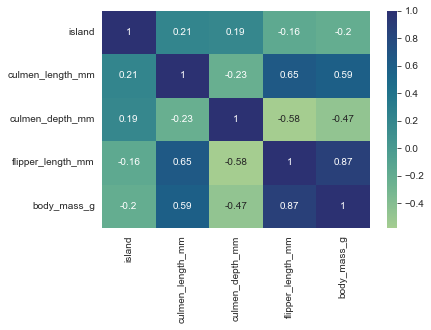

In [38]:
# Generazione matrice di correlazione
sns.heatmap(peng.corr(), annot=True, cmap='crest')

Quindi ho deciso di utilizzare per la classificazione le tre *features* che risultavano maggiormente significative dalla dalla matrice di correlazioni: dimensione delle pinne, massa e spessore del becco. 

In [39]:
# Sostituzione della colonna 'species' con i numeri corrispondenti
y = peng['species'].replace(species_to_num)
X = peng[['flipper_length_mm', 'body_mass_g', 'culmen_length_mm']]

names=X.columns

# Normalizzazione tra 0 e 1
X=(X-X.min())/(X.max()-X.min())
X=np.array(X)
X=X.reshape(334, 3)

### Visualizzazione tridimensionale del dataset

In [40]:
# Primo scatterplot 3d dei dati selezionati
fig = go.Figure()
species_name= ['Yellow:Adeline, Purple:Gentoo, Blue:Chimstrap']
fig.add_trace(go.Scatter3d(
    x=X[:, 0],
    y=X[:, 1],
    z=X[:, 2],
    name=' '.join(species_name),

    mode='markers',
    marker=dict(
        size=5,
        color=y,
        opacity=0.8,
        line=dict(color='black',
                width=12)
    )
))

fig.update_layout(
    showlegend=True,
    scene=dict(
        xaxis_title=names[0],
        yaxis_title=names[1],
        zaxis_title=names[2]
    )
)


fig.show()

## Classificatore K-NN 

Il primo metodo di classificazione che ho deciso di implementare è basato sul'algoritmo di *K-Nearest Neighbors* (K-NN). Questo algoritmo particolarmente semplice calcola la distanza tra un singolo punto con tutti quelli del dataset, restituendo i k più vicini (valore k passato dall'esterno). 
L'algoritmo viene formalizzato in questo modo: 

$${f(x)=\textstyle \displaystyle{1 \over K}\displaystyle \sum_{k=1}^{K}y_{i_{k}}}$$

con le conseguenti condizioni:  

$${\exists \, d \in \mathbb{R}: \hspace{0.5cm}k\le K \Rightarrow \Vert x-x_{i_{k}} \Vert<d \hspace{0.5cm}  \wedge \hspace{0.5cm} k>K \Rightarrow \Vert x-x_{i_{k}} \Vert>d}$$

Per cominciare ho diviso il dataset in train set e test set con un rappporto di 0.2 per il test e 0.8 per il training. Ho effettuato un primo fit con ${k=5}$ e valutato l'accuracy, dopodiché ho proceduto a generare il boundary.


<img src="schema_knn.png" width="400" height="400">

In [41]:
# Create an instance of Neighbors Classifier and fit the data.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

k=5
knn = neighbors.KNeighborsClassifier(n_neighbors=k)
knn.fit(X, y)
y_pred = knn.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy con K=5 :", accuracy)

Accuracy con K=5 : 0.9850746268656716


## Generazione del boundary

Ho generato un boundary tridimensionale partendo da una griglia di valori tridimensionali. Per prima cosa ho campionato tutto il volume del grafico con una griglia tridimensionale, dopodichè, una volta reso un array di dimensione (*features*, N-*samples*), ho effettuato una predizione per ogni punto della griglia, assegnandoci quindi una specie predetta. 


In [42]:

def boundary(model, dataset):
    x_min, x_max = (dataset[:, 0].min() - 1), (dataset[:, 0].max() + 1)
    y_min, y_max = (dataset[:, 1].min() - 1), (dataset[:, 1].max() + 1)
    z_min, z_max = (dataset[:, 2].min() - 1), (dataset[:, 2].max() + 1)

    xx, yy, zz = np.mgrid[x_min:x_max:30j,  y_min:y_max:30j,   z_min:z_max:30j]

    data = {'flipper_length_mm': xx.ravel(),
            'body_mass_g': yy.ravel(),
            'culmen_length_mm': zz.ravel()
            } 

    df = pd.DataFrame(data).values
    predictions = model.predict(df)

    return predictions, xx, yy, zz

Infine ho normalizzato tra 0 e 1 i valori delle previsioni ottenute, che risultavano compresi tra 0 e 2 a causa del dizionario impartito precedentemente. 


In [43]:
def normalize(predictions):

    predictions = (predictions - np.min(predictions))/ (np.max(predictions) - np.min(predictions))
    return predictions

Qui invece ho scritto una funzione per generare un grafico contentente il boundary e lo scatterplot dei dati

In [44]:
def graph_boundary(density, dataset, xx, yy, zz, labels):

    fig = go.Figure(data=go.Volume(
        x=xx.flatten(),
        y=yy.flatten(),
        z=zz.flatten(),
        value=density.flatten(),
        isomin=0,
        isomax=1,
        opacity=0.1,
        surface_count=21,
        ))

    fig.add_trace(go.Scatter3d(
        x=dataset[:, 0],
        y=dataset[:, 1],
        z=dataset[:, 2],
        mode='markers',
        marker=dict(
            size=5,
            color=labels,
            opacity=0.8,
            line=dict(color='black',
            width=12)
        )
    ))

    fig.update_layout(
        showlegend=True, 
        scene=dict(
            xaxis_title=names[0],
            yaxis_title=names[1],
            zaxis_title=names[2], 

        )
    )

    fig.show()

In [45]:
def graph_boundary_pca(density, dataset, xx, yy, zz, labels):

    fig = go.Figure(data=go.Volume(
        x=xx.flatten(),
        y=yy.flatten(),
        z=zz.flatten(),
        value=density.flatten(),
        isomin=0,
        isomax=1,
        opacity=0.1,
        surface_count=21,
        ))

    fig.add_trace(go.Scatter3d(
        x=dataset[:, 0],
        y=dataset[:, 1],
        z=dataset[:, 2],
        mode='markers',
        marker=dict(
            size=5,
            color=labels,
            opacity=0.8,
            line=dict(color='black',
            width=12)
        )
    ))

    fig.update_layout(
        showlegend=True, 
        scene=dict(
            xaxis_title='Component 1',
            yaxis_title='Component 2',
            zaxis_title='Component 3', 

        )
    )

    fig.show()

In [46]:
predictions, xx, yy, zz = boundary(knn, X)

In [47]:
density=normalize(predictions)
graph_boundary(density, X, xx, yy, zz, y)

Dopo aver generato il boundary ho effettauto 20 predizioni, aumentando di 1 il numero di *K-Neighbors* ad ogni ciclo e calcolando l'accuracy. Ho effettuato uno scatterplot per evidenziare graficamente i risultati: si nota appunto che l'accuratezza del modello si abbassa all'aumentare del numero di vicini utilizzati. Questo in realtà suona palusibile per il fatto che per un numero di k troppo piccolo, il modello risulta troppo complesso e facilmente tende all'overfitting, mentre invece con un numero di k troppo elevato il modello risulta troppo semplice, andando in underfitting. 

Accuracy K= 1 :  0.9552238805970149
Accuracy K= 6 :  0.9701492537313433
Accuracy K= 11 :  0.9850746268656716
Accuracy K= 16 :  0.9850746268656716
Accuracy K= 21 :  0.9850746268656716
Accuracy K= 26 :  0.9850746268656716
Accuracy K= 31 :  0.9850746268656716
Accuracy K= 36 :  0.9850746268656716
Accuracy K= 41 :  0.9701492537313433
Accuracy K= 46 :  0.9701492537313433
Accuracy K= 51 :  0.9701492537313433
Accuracy K= 56 :  0.9701492537313433
Accuracy K= 61 :  0.9701492537313433
Accuracy K= 66 :  0.9701492537313433
Accuracy K= 71 :  0.9701492537313433
Accuracy K= 76 :  0.9552238805970149
Accuracy K= 81 :  0.9402985074626866
Accuracy K= 86 :  0.9552238805970149
Accuracy K= 91 :  0.9552238805970149
Accuracy K= 96 :  0.9552238805970149


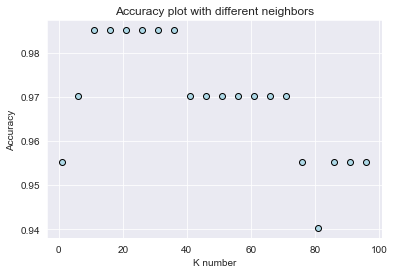

In [48]:
for i in range(20):

    clf = neighbors.KNeighborsClassifier(n_neighbors=5*i+1)
    clf.fit(X_train, y_train)

    # Effettua le predizioni sui dati di test
    y_pred = clf.predict(X_test)

    # Calcola l'accuratezza del modello
    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy K=", 5*i+1, ': ', accuracy)
    plt.scatter(5*i+1, accuracy, color='lightblue', edgecolors='black')
plt.xlabel('K number')
plt.ylabel('Accuracy')
plt.title('Accuracy plot with different neighbors')
plt.show()

## Ricampionamento con metodo Bootstrap

Per ottenere una stima effettiva delle prestazioni del modello, ho effettuato un ricampionamento tramite il metodo Bootstrap. Tale metodo prevede, una volta effettuata una divisione in dati di test e di training, di effettuare un allenamento su dei dataset ridotti effettuati prelevando in modo randomico un numero di subset di dimensione minore rispetto al training set. Ho effettuato un fit e una predizione per ogni iterazione, dopodiché ho calcolato l'accuracy e effettuato una media delle prestazioni ottenute.


<img src="bootstrap.png" width="700" height="700">

In [15]:
def bootstrap(x, y, xtest, ytest, model, steps, dim_boot):

    models = []
    performances = []
    X_boot=[]
    # Esecuzione del bootstrap sul set di addestramento
    for _ in range(steps):
        
        # Generazione di un campione bootstrap
        X_boot, y_boot = resample(X_train, y_train, replace=True, n_samples=dim_boot)
        
        # Creazione e addestramento del modello 
        model.fit(X_boot, y_boot)

        # Calcolo della prestazione
        accuracy = model.score(X_test, y_test)
        performances.append(accuracy)

        models.append(model)

    # Calcolo delle prestazioni medie
    mean_performance = np.mean(performances)

    print("Prestazioni medie: ", mean_performance * 100, "%")

In [16]:
bootstrap(X_train, y_train, X_test, y_test, knn, 1000, 150)

Prestazioni medie:  95.93134328358207 %


## Support Vector Machines

Il secondo metodo che ho deciso di implementare è basato sul Suoport Vector Machines. 
Questo metodo mira a trovare il giusto iperpiano che massimizza la distanza tra le classi (*labels*) in cui è suddiviso il dataset. In particolare massimizza la distanza tra i punti che si trovano maggiormente vicini alla classe avversa, e questi punti vengono chiamari proprio *vettori di supporto*. 

Il problema di ottimizzazione nel caso lineare si riduce quindi a:

$${y_{i}^{T}(x_{i}^{T} \beta + \beta_{0}) \ge M}$$

dove la larghezza del margine risulta essere $2M$.


<img src="SVM.png" width="400" height="400">

Quindi, per poter effettuare una classificazione, devo trovare il miglior predittore effettuando una minimizzazione della funzionie di costo, che in questo caso si riduce ad un problema quadratico risolvibile tramite i moltiplicatori di Lagrange. 
$${L_{p}=\frac{1}{2} \Vert{\beta} \Vert^{2} +c\sum_{i=1}^{N} \xi_{i} -\sum_{i=1}^{N}a_{i}[y_{i}(x_{i}^{T}\beta_{i}+\beta_{0})-(1+\xi_{i})]-\sum_{i=1}^{N}\mu_{i}\xi_{i}}$$

Effettuata la minimizzazione, il miglior predittore che si ottiene risulta essere:  

$${\hat{\beta}=\displaystyle \sum_{i=1}^{N}\hat{a}_{i}x_{i}y_{i}}$$

Per la classificazione non lineare, è possibile utilizzare le funzioni di kernel, per passare ad uno spazio con più alta dimensionalità. Questo apporta un notevole vantaggio poiché risulta possibile generare anche margini non lineari, che spesso risultano essere maggiormente accurati. Esistono vari tipi di funzioni kernel, nel mio lavoro mi sono concentrato su: 
* kernel gaussiano (rbf)
* kernel polinomiale
* kernel lineare

In [17]:
def load_dataset():
    sns.set_style('darkgrid')

    peng = pd.read_csv("penguins_size.csv")

    peng = peng.dropna()

    le = LabelEncoder()
    island_num = {'Torgersen': 0, 'Biscoe': 1, 'Dream': 2}
    sex_to_num = {'FEMALE' : 0, 'MALE' : 1}
    species_to_num = {'Adelie': 0, 'Chinstrap': 1, 'Gentoo': 2}
    peng['species'] = peng['species'].replace(species_to_num)
    peng['island'] = peng['island'].replace(island_num)
    peng['sex'] = peng['sex'].replace(sex_to_num)


    numeric_cols = peng.select_dtypes(include=["int64", "float64", "int32"]).columns
    features=peng.select_dtypes(include=["int64", "float64"])

    FeatureNames=peng.columns

    X_ = features
    y_ = peng["species"]
    return X_, y_, numeric_cols

In [18]:
X, y, numcol=load_dataset()

### Riduzione dimensionale tramite PCA

Il metodo del *Principle component of analysis* (PCA), è un metodo di riduzione dimensionale molto utilizzato. Esso si basa sull'individuare le direzioni del dataset che che massimizzano la varianza della distribuzione e proiettare i dati in uno spazio generato proprio da questi vettori.

Il teorema della pca afferma infatti che: 
* dato un certo dataset ${D=\{(x_{i}, y_{i}), i=1, 2, ...N\} \in \mathbb{R}^{P}}$ a media nulla
* dato ${P>p}$ con ${p, P \in \mathbb{N}}$

Il sottospazio ${S \in \mathbb{R}^{p}}$ che massimizza la varianza della distribuzione è dato dai primi p autovettori ${(v_{1}, v_{2}, ..., v_{p})}$ dell matrice di covarianza ${C[x]}$ corrispondenti ai P autovalori più grandi. 

Non ho utilizzato questo metodo per il modello KNN poiché esso prende proprio informazione dalla distanza tra i punti del dataset, quindi proiettarsi in uno spazio differente avrebbe inficiato sulle prestazioni e falsato le predizioni. 

<img src="pca.png" width="500" height="500">

In [19]:
# Riduzione dimensionale tramite PCA
def myPCA(dataset, labels, col):
    pca = PCA(n_components=3)
    reduced = pca.fit_transform(dataset)

    names=[col[pca.components_[0].argmax()], col[pca.components_[1].argmax()], col[pca.components_[2].argmax()]]
    scaler=MinMaxScaler()
    reduced = scaler.fit_transform(reduced)
    return reduced



In [20]:
X_reduced=myPCA(X, y, numcol)
X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.2, random_state=42)



### Kernel rbf (Radial Basis Function)

In [21]:
# Creazione del modello SVM
svm_model_rbf = SVC(kernel='rbf')

# Addestramento del modello
svm_model_rbf.fit(X_train, y_train)

# Valutazione del modello
accuracy = svm_model_rbf.score(X_test, y_test)
print("Accuracy:", accuracy)

Accuracy: 1.0


### Kernel polinomiale

In [22]:
svm_model_poly = SVC(kernel='poly')

svm_model_poly.fit(X_train, y_train)

accuracy = svm_model_poly.score(X_test, y_test)
print("Accuracy:", accuracy)

Accuracy: 0.9701492537313433


### Kernel lineare

In [23]:
svm_model_lin = SVC(kernel='linear')

svm_model_lin.fit(X_train, y_train)

accuracy = svm_model_lin.score(X_test, y_test)
print("Accuracy:", accuracy)

Accuracy: 1.0


### Ricampionamento bootstrap

Visto che effettuando un solo training l'accuracy del kernel lineare e rbf risultano pari a 1, è necessario effettuare un ricampionamento tramite bootstrap per capire effettivamente quale dei due metodi sia il migliore da utilizzare. 

In [24]:
bootstrap(X_train, y_train, X_test, y_test, svm_model_lin, 1000, 150)

Prestazioni medie:  99.60149253731343 %


In [25]:
bootstrap(X_train, y_train, X_test, y_test, svm_model_rbf, 1000, 150)

Prestazioni medie:  99.1641791044776 %


In [26]:
bootstrap(X_train, y_train, X_test, y_test, svm_model_poly, 1000, 150)

Prestazioni medie:  97.61492537313433 %


## Decision Boundary

Visto che il kernel che riscontra l'accuratezza più alta risulta essere quello lineare, ho deciso di effettuare il *decision boundary* effettuando predizioni basate su tale modello. Ho utilizzato lo stesso metodo svolto nel caso della classificazione con KNN. Dopodichè ho effettuato dei boudaries anche con kernel polinomiale e gaussiano. 

In [27]:
predictions, xx, yy, zz = boundary(svm_model_lin, X_reduced)
density=normalize(predictions)
graph_boundary_pca(density, X_reduced, xx, yy, zz,  y)

In [28]:
predictions, xx, yy, zz = boundary(svm_model_rbf, X_reduced)
density=normalize(predictions)
graph_boundary_pca(density, X_reduced, xx, yy, zz,  y)

In [29]:
predictions, xx, yy, zz = boundary(svm_model_poly, X_reduced)
density=normalize(predictions)
graph_boundary_pca(density, X_reduced, xx, yy, zz,  y)

Si nota come il kernel che separa in modo più netto i dati risulta essere quello lineare, nonchè quello più accurato. Detto questo, se le classi non sono separabili da piani bidimensionali, conviene utilizzare un modello con kernel differente. 

## Regressione Logistica

Il terzo metodo che ho deciso di implementare si basa sulla regressione logistica. Il metodo coonsiste nel riuscire ad esprimere la porbabilità bayesiana che un certo punto ${x_{i}}$ appartenga ad una determinata classe K attraverso il fromalismo della regressione lineare: 

$${\log \frac{P(G=1|X=x)}{P(G=K|X=x)}=\beta_{1_{0}}+x^{T}\beta_{1}}$$

$${\log \frac{P(G=2|X=x)}{P(G=K|X=x)}=\beta_{2_{0}}+x^{T}\beta_{2}} $$

$${\vdots}$$

 
Una volta effettuata questa analogia, esprimo la probabilità per la regressione logistica imponendo la condizione di normalizzazione sulle classi: 

$${\displaystyle \frac{1}{P_{k}}=\displaystyle \sum_{l=1}^{K}\frac {P_{l}}{P_{K}}=1+\displaystyle \sum_{l=1}^{K}e^{\beta_{l_{0}}+x^{T}\beta_{l}}}$$


Quindi posso infine descrivere la probabilità in questo modo: 

$${P_{L}(x)=\displaystyle \frac{\sum_{l=1}^{L}e^{\beta_{0_{l}}+x^{T}\beta_{l}}}{1+\sum_{l=1}^{L}e^{\beta_{0_{l}}+x^{T}\beta_{l}}}}$$  

$${P_{K}(x)=\displaystyle \frac{1}{1+\sum_{k=1}^{K}e^{\beta_{0_{k}}+x^{T}\beta_{k}}}}$$ 

Questa è appunto la probabilità di ottenere una determinata classe dato un determinato punto nel dataset. Dopodiché, per trovare il miglior predittore tramite metodo di massima verosimiglianza calcolato un metodo, per esempio, di Newton o *IRLS* di:

$${\hat{\beta}=\underset{\beta}{\arg\max} \biggl \{\displaystyle \prod_{i=1}^{N}\biggl (\prod_{l=1}^{K} \hat{P}_{l}(x)^{\delta_{ g_{i, k}}}\biggr)\biggr \}}$$

### Caricamento del dataset

In [30]:
from sklearn.linear_model import LogisticRegression


X, y, numcol=load_dataset()
X_reduced=myPCA(X, y, numcol)
X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.2, random_state=42)


### Generazione del modello e fit

In [31]:
# Modello
LogReg = LogisticRegression(max_iter=1000)

#Training
LogReg.fit(X_train, y_train)

# Accuracy del modello
y_pred = LogReg.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 1.0


### Generazione del boundary

In [32]:
predictions, xx, yy, zz = boundary(LogReg, X_reduced)
density=normalize(predictions)
graph_boundary(density, X_reduced, xx, yy, zz, y)

### Bootstrap

In [33]:
bootstrap(X_train, y_train, X_test, y_test, LogReg, 1000, 150)

Prestazioni medie:  97.97611940298508 %


# Conclusioni

Ho implementato tre metodi atti alla classificazione in base alla specie di un dataset contenente caratteristiche fisiche e di provenineza di 344 pinguini antartici. I metodi che ho implementato sono stati:

* K-Nearest Neighbords (K-NN)
* Support Vector Machines (SVM)
* Regressione logistica lineare

Ho effettuato una verifica dell'accuracy e delle prestazioni medie dei modelli utilizzati tramite il metodo di ricampionamento Bootstrap e generato dei grafici contenenti i decision boundaries tridimensionali che suddividono il piano in base alla probabilità di appartenere ad una determinata classe date determinate *features*. 

Per concludere, il modello che ha conseguito la miglior performance media di classificazione risulta essere il metodo dei Support Vector Machines con kernel lineare. Nonostante questo, le prestazioni di tutti gli altri modelli implementati risultavano comunque elevate, tutti con accuarcy superiore al 95%.

Come sviluppo fututo del mio lavoro si potrebbe implementare del codice che effettaua altri tipi di regressione logistica con metodi non lineari (per esempio gaussiano) e quanitificare le loro prestazioni. Inoltre si potrebbe effettuare un'ottimizazzione degli iperparametri delle architetture di SVM e regressione logistica tramite le librerie optuna oppure hyperopt per capire quale sia la conformazione ideale che massimizza l'accuracy. 

### Bibliografia

Codice per effettuare grafici volumetrici: <https://plotly.com/python/3d-volume-plots/>

Teoria dei metodi implementati: 
* <https://hastie.su.domains/Papers/ESLII.pdf>
* Slides del corso di Machine Learning con applicazioni, Carlo Barbieri

Libreria per l'mplementazione dei modelli: 
* scikit-learn: <https://scikit-learn.org/>

Altre librerie:
* numpy: <https://numpy.org/>
* seaborn: <https://seaborn.pydata.org/>